In [1]:
print("hi")

library("cowplot")

[1] "hi"


In [2]:
# Himba_meth_data <- read.table("Himba_meth_phenos.tsv", header=TRUE)
# KHS_meth_data <- read.table("KHS_meth_phenos.tsv", header=TRUE)
# Baka_meth_data <- read.table("Baka_meth_phenos.tsv", header=TRUE)
# all_meth_data <- read.table("all_meth_phenos.tsv", header=TRUE)
load("invariants.RData")

library("ggplot2")
library("dplyr")
load("/share/hennlab/users/glmeeks/age_methylation/EMMAX_meqtl/meqtl_cpgs.RData")
process_column_name <- function(cpg) {
  cpg_ <- strsplit(cpg, split = "_")[[1]][2]
  cpg_ <- strsplit(cpg_, split = "\\.txt")[[1]][1]  
  return(cpg_)
}

# # Set working directory
# setwd("/share/hennlab/users/glmeeks/age_methylation/EMMAX_meqtl/")
# save(list=c("Himba_meth_data", "KHS_meth_data", "Baka_meth_data", "all_meth_data"), file="meth_data_pops.RData")
load("meth_data_pops.RData")
load("/share/hennlab/users/glmeeks/age_methylation/methylation_norm_EWAS/Diverse_Age_QC_methylation_phenos.RData")



Attaching package: 'dplyr'


The following objects are masked from 'package:stats':

    filter, lag


The following objects are masked from 'package:base':

    intersect, setdiff, setequal, union




In [3]:
# load("/share/hennlab/users/glmeeks/age_methylation/EMMAX_meqtl/metagen_sig_fixed_no_meqtl_regress.RData")
# meta_sig_no_regress <- sig
# load("/share/hennlab/users/glmeeks/age_methylation/EMMAX_meqtl/metagen_sig_fixed_meqtl_regress.RData")
# meta_sig_regress <- sig
# ls()

# only_regress_sig <- meta_sig_regress$CPG.Labels[!meta_sig_regress$CPG.Labels %in% meta_sig_no_regress$CPG.Labels]
# length(only_regress_sig)


Attaching package: 'patchwork'


The following object is masked from 'package:cowplot':

    align_plots




[1] "Himba"
# A tibble: 1 x 1
  V2             
  <chr>          
1 3:108383418:A:T
[1] "KHS"
# A tibble: 1 x 1
  V2             
  <chr>          
1 1:169542712:T:C
[1] "Baka"
# A tibble: 1 x 1
  V2             
  <chr>          
1 12:19369028:A:G


Warning message:
"Removed 3 rows containing missing values or values outside the scale range (`geom_point()`)."
Warning message:
"Removed 1 row containing missing values or values outside the scale range (`geom_point()`)."


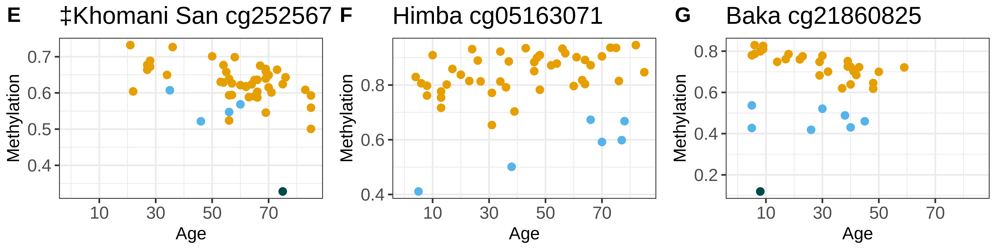

In [4]:
#######################
library("patchwork")
library("ggplot2")
library("dplyr")
cbPalette <- c("#E69F00", "#56B4E9", "#009E73", "#F0E442", "#0072B2", "#D55E00", "#CC79A7")

# Initialize a list to store plots for each population
cpg_plot_list <- list()

for (pop_ in c("Himba", "KHS", "Baka")) {

  pop <- pop_
  # meta_ewas_regress <- FALSE
  # if (meta_ewas_regress) {
  #   sig <- meta_sig_regress
  # } else {
  #   sig <- meta_sig_no_regress
  # }

  # Load phenotype data based on the population
  if (pop == "KHS") {
    pheno <- KHS_pheno_merged
    rownames(pheno) <- pheno$IID
    tfam <- read.delim("/share/hennlab/users/glmeeks/age_methylation/EMMAX_meqtl/beta_meqtl_regress_KHS.tfam", sep = '', header = FALSE)
    n <- 52
  } else if (pop == "Baka") {
    pheno <- Baka_pheno
    rownames(pheno) <- pheno$IID
    tfam <- read.delim("/share/hennlab/users/glmeeks/age_methylation/EMMAX_meqtl/beta_meqtl_regress_Baka.tfam", sep = '', header = FALSE)
    n <- 35
  } else if (pop == "Himba") {
    pheno <- Himba_pheno_merged
    rownames(pheno) <- pheno$ID
    pheno$IID <- pheno$ID
    pheno <- pheno[!pheno$ID == "HMB181_2", ]
    n <- 51
    tfam <- read.delim("/share/hennlab/users/glmeeks/age_methylation/EMMAX_meqtl/beta_meqtl_regress_Himba.tfam", sep = '', header = FALSE)
  } else if (pop == "all") {
    load("/share/hennlab/users/glmeeks/age_methylation/age_prediction/merged_data_all_phenos.RData")
    pheno <- pheno_merged
    rownames(pheno) <- pheno$ID
    pheno$IID <- pheno$ID
    n <- 138
    tfam <- read.delim("/share/hennlab/users/glmeeks/age_methylation/EMMAX_meqtl/beta_all_no_regress.tfam", sep = '', header = FALSE)
  }

  meth_data <- get(paste0(pop, "_meth_data"))
  row_index <- which(colnames(meth_data) == "HMB494.2")
  names(meth_data)[row_index] <- "HMB494-2"
  pheno <- pheno[c(colnames(meth_data[, 5:ncol(meth_data)])), ]
  meth_ <- t(meth_data[, 5:ncol(meth_data)])
  colnames(meth_) <- meth_data$cpg
  meqtls_df <- read.table(paste0(pop, "_meqtls.txt"), sep = ",", header = FALSE)
  meqtls_df$V1 <- sapply(meqtls_df[, 1], process_column_name)

  ###only regress out lowest p-value snp##
  meqtls_df <- meqtls_df %>%
    group_by(V1) %>%
    filter(V4 == min(V4)) %>%
    slice(1) %>%  
    ungroup()

    #biggest p-val difference ones
# if(pop == "KHS"){biggest <- c("cg23448486")}
# if(pop == "Baka"){biggest <- c("cg15060012")}
# if(pop == "Himba"){biggest <- c("cg01265905")}
#     #invariant ones
if(pop == "KHS"){biggest <- c("cg25256723")}
if(pop == "Baka"){biggest <- c("cg21860825")}
if(pop == "Himba"){biggest <- c("cg05163071")}
    
# if(pop == "KHS"){biggest <- unique(KHS_invariant)[20]}
# if(pop == "Baka"){biggest <- unique(Baka_invariant)[27]}
# if(pop == "Himba"){biggest <- unique(Himba_invariant)[19]}

    
    #clock cpg ones
# if(pop == "KHS"){biggest <- c('cg00945507','cg01032119','cg02382878','cg04718414','cg04718414','cg06975196','cg06975196',
# 'cg09809672','cg10586358','cg11388238','cg13319175','cg13319175','cg16054275','cg16063587','cg18392482','cg18771300','cg19514928',
# 'cg21363706','cg25256723')}
# if(pop == "Baka"){biggest <- c('cg00285394','cg00285394','cg00285394','cg00285394','cg02332492','cg03019000','cg04727522',
# 'cg04958045','cg05759269','cg05759269','cg06434732','cg06434732','cg06434732','cg06434732','cg06434732','cg06589199','cg06589199',
# 'cg06589199','cg08903441','cg10686758','cg12261786','cg14723032','cg17589341','cg19008809','cg21363706','cg21363706','cg22026616',
# 'cg22736354','cg24593138','cg24593138','cg24827660','cg25424937')}
# if(pop == "Himba"){biggest <- c('cg00285394','cg00285394','cg00285394','cg01261503','cg01261503','cg01623187','cg01623187','cg01623187',
# 'cg05163071','cg05163071','cg05163071','cg05163071','cg06434732','cg06434732','cg06434732','cg08166272','cg08166272','cg08251399',
# 'cg08879886','cg08903441','cg09029902','cg09196959','cg11356552','cg11356552','cg11618577','cg15731317','cg15910502','cg20914508',
# 'cg21878650','cg25587481','cg25587481')}
                   
  # Generate plots and store them in a list
  for (cpg_ in biggest) {
    meth <- as.data.frame(meth_[, colnames(meth_) == cpg_])
    meth$ID <- rownames(meth)
    snp_name <- meqtls_df[meqtls_df$V1 == cpg_, "V2"]
      print(pop)
      print(snp_name)
    file_path <- paste0(pop, "_meqtl_genos/", snp_name, "_meqtl.txt")
    snp_data <- read.delim(file_path, header = FALSE, sep = "|")
    snp_data$sum_alleles <- sapply(snp_data$V7, function(x) {
      if (x == "0/0") {
        return(0)
      } else if (x == "0/1") {
        return(1)
      } else if (x == "1/1") {
        return(2)
      } else {
        return(NA)
      }
    })
    snp_data$V6 <- gsub(".*_", "", snp_data$V6)
    rownames(snp_data) <- snp_data$V6
    snp_data <- snp_data[rownames(meth), ]
    pheno <- pheno[rownames(meth), ]
    snp_data$ID <- rownames(snp_data)
    snp_data$meth_value <- meth[match(snp_data$ID, meth$ID), 1]
    snp_data$age <- pheno[match(snp_data$ID, pheno$IID), "age"]
      if(pop == "KHS") {pop <- "\u2021Khomani San"}
     gg <- ggplot(snp_data, aes(x = age, y = meth_value, color = factor(sum_alleles))) +
      geom_point(size = 11) +  # Increase point size here
      labs(x = "Age", y = "Methylation", title = paste0(pop, " ", cpg_), color = "Genotype") +
      theme_minimal() +
      scale_color_manual(values = c("#E69F00", "#56B4E9", "#004949")) +  # Adjust colors as needed
     theme_bw() + 
     theme_bw(base_size = 50) + 
  theme(legend.position = "none",
        axis.text = element_text(size = 50),
        axis.title = element_text(size = 50, margin = margin(r = 10)),
         
        plot.title = element_text(size = 70 ), plot.margin = margin(t = 20, r = 30, b = 20, l = 20))+
      scale_x_continuous(limits = c(0, 85), breaks = seq(10 ,80, by = 20)) #+  # Set x-axis limits and breaks
#scale_y_continuous(limits = c(0, 1), breaks = seq(0, 1, by = 0.25)) 

      


# if(pop == "Baka") { gg <- ggplot(snp_data, aes(x = age, y = meth_value, color = factor(sum_alleles))) +
#       geom_point(size = 11) +  # Increase point size here
#       labs(x = "Age", y = "Methylation", title = paste0(pop, " ", cpg_), color = "Genotype") +
#       theme_minimal() +
#       scale_color_manual(values = c("#E69F00", "#56B4E9", "#004949")) +  # Adjust colors as needed
#       theme_bw() + 
#       theme(
#         axis.text = element_text(size = 60),
#         axis.title = element_text(size = 70, margin = margin(r = 10)),
#         plot.title = element_text(size = 55 ),
#         legend.text = element_text(size = 70),  # Increase legend text size
#         legend.title = element_text(size = 70),  # Increase legend title size
#      plot.margin = margin(t = 20, r = 20, b = 20, l = 20),
#           legend.position = "bottom" # Add margin around the plot
# )  +
#       scale_x_continuous(limits = c(0, 90), breaks = seq(10 ,90, by = 20)) #+  # Set x-axis limits and breaks
# #scale_y_continuous(limits = c(0, 1), breaks = seq(0, 1, by = 0.25)) 
# }
      
      } 
    cpg_plot_list[[pop]] <- gg
  }


combined_plot <- plot_grid(
  cpg_plot_list[["\u2021Khomani San"]],
  cpg_plot_list[["Himba"]],
  cpg_plot_list[["Baka"]],
  ncol = 3,
  labels = c("E", "F", "G"),
  label_size = 60,
  rel_widths = c(1, 1, 1)
)

# Print the combined plot
options(repr.plot.width = 40, repr.plot.height = 10)
#svg("/share/hennlab/users/glmeeks/age_methylation/EMMAX_meqtl/Figure4b.svg", width = 50, height = 15)
print(combined_plot)
#dev.off()
#save(list= c("combined_plot"), file="most_improved_sites_pop_split_meqtl.RData")
save(list= c("combined_plot"), file="invariant_meqtl.RData")


In [5]:
# library("patchwork")
# library("ggplot2")
# library("dplyr")
# cbPalette <- c("#E69F00", "#56B4E9", "#009E73", "#F0E442", "#0072B2", "#D55E00", "#CC79A7")
# options(repr.plot.width = 10, repr.plot.height = 10)

# # Initialize a list to store plots for each population
# cpg_plot_list <- list()

#   pop <- "Baka"
#   # meta_ewas_regress <- FALSE
#   # if (meta_ewas_regress) {
#   #   sig <- meta_sig_regress
#   # } else {
#   #   sig <- meta_sig_no_regress
#   # }

#   # Load phenotype data based on the population
#   if (pop == "KHS") {
#     pheno <- KHS_pheno_merged
#     rownames(pheno) <- pheno$IID
#     tfam <- read.delim("/share/hennlab/users/glmeeks/age_methylation/EMMAX_meqtl/beta_meqtl_regress_KHS.tfam", sep = '', header = FALSE)
#     n <- 52
#   } else if (pop == "Baka") {
#     pheno <- Baka_pheno
#     rownames(pheno) <- pheno$IID
#     tfam <- read.delim("/share/hennlab/users/glmeeks/age_methylation/EMMAX_meqtl/beta_meqtl_regress_Baka.tfam", sep = '', header = FALSE)
#     n <- 35
#   } else if (pop == "Himba") {
#     pheno <- Himba_pheno_merged
#     rownames(pheno) <- pheno$ID
#     pheno$IID <- pheno$ID
#     pheno <- pheno[!pheno$ID == "HMB181_2", ]
#     n <- 51
#     tfam <- read.delim("/share/hennlab/users/glmeeks/age_methylation/EMMAX_meqtl/beta_meqtl_regress_Himba.tfam", sep = '', header = FALSE)
#   } else if (pop == "all") {
#     load("/share/hennlab/users/glmeeks/age_methylation/age_prediction/merged_data_all_phenos.RData")
#     pheno <- pheno_merged
#     rownames(pheno) <- pheno$ID
#     pheno$IID <- pheno$ID
#     n <- 138
#     tfam <- read.delim("/share/hennlab/users/glmeeks/age_methylation/EMMAX_meqtl/beta_all_no_regress.tfam", sep = '', header = FALSE)
#   }

#   meth_data <- get(paste0(pop, "_meth_data"))
#   row_index <- which(colnames(meth_data) == "HMB494.2")
#   names(meth_data)[row_index] <- "HMB494-2"
#   pheno <- pheno[c(colnames(meth_data[, 5:ncol(meth_data)])), ]
#   meth_ <- t(meth_data[, 5:ncol(meth_data)])
#   colnames(meth_) <- meth_data$cpg
#   meqtls_df <- read.table(paste0(pop, "_meqtls.txt"), sep = ",", header = FALSE)
#   meqtls_df$V1 <- sapply(meqtls_df[, 1], process_column_name)

#   ###only regress out lowest p-value snp##
# meqtls_df <- meqtls_df[meqtls_df$V4 > 0,]
# meqtls_df <- meqtls_df %>%
#     group_by(V1) %>%
#     filter(V4 == min(V4)) %>%
#     slice(1) %>%
#     ungroup() %>%
#     arrange(V4) 
#     #most sig meqtl

# if(pop == "KHS"){biggest <- sample(meqtls_df$V1, 1) }
# if(pop == "Baka"){biggest <- sample(meqtls_df$V1, 1)}
# if(pop == "Himba"){biggest <- sample(meqtls_df$V1, 1)}
# print(pop)

#   # Generate plots and store them in a list
# cpg_ <- "cg04958045"
#     meth <- as.data.frame(meth_[, colnames(meth_) == cpg_])
#     meth$ID <- rownames(meth)
#     snp_name <- meqtls_df[meqtls_df$V1 == cpg_, "V2"]
#     snp_name <- "17:13526970:T:C"
#     file_path <- paste0(pop, "_meqtl_genos/", snp_name, "_meqtl.txt")
#     snp_data <- read.delim(file_path, header = FALSE, sep = "|")
#     snp_data$sum_alleles <- sapply(snp_data$V7, function(x) {
#       if (x == "0/0") {
#         return(0)
#       } else if (x == "0/1") {
#         return(1)
#       } else if (x == "1/1") {
#         return(2)
#       } else {
#         return(NA)
#       }
#     })
#     snp_data$V6 <- gsub(".*_", "", snp_data$V6)
#     rownames(snp_data) <- snp_data$V6
#     snp_data <- snp_data[rownames(meth), ]
#     pheno <- pheno[rownames(meth), ]
#     snp_data$ID <- rownames(snp_data)
#     snp_data$meth_value <- meth[match(snp_data$ID, meth$ID), 1]
#     snp_data$age <- pheno[match(snp_data$ID, pheno$IID), "age"]
#       if(pop == "KHS") {pop <- "Khomani San"}
# ggplot(snp_data, aes(x = as.factor(sum_alleles), y = meth_value)) +
#   geom_boxplot(outlier.shape = NA) +  # Boxplot with outline only, no fill, no outliers
#   geom_jitter(size = 4, width = 0.2) +  # Add jittered points with increased size and slight horizontal spread
#   labs(x = "Genotype", y = "Methylation", title = paste0(pop, " ", cpg_), color = "Genotype") +
#   theme_bw() + 
#   theme(
#     axis.text = element_text(size = 35),
#     axis.title = element_text(size = 35, face = "bold",  margin = margin(r = 10)),
#     plot.title = element_text(size = 33, face = "bold"),
#     legend.text = element_text(size = 30),  # Increase legend text size
#     legend.title = element_text(size = 30)  # Increase legend title size
#   ) + 
#   theme(legend.position = "none")


In [6]:
pop <- "Himba"
summary <- read.delim(paste0("/share/hennlab/users/glmeeks/age_methylation/FUSION/", pop, "_fusion_summary_full_no_blup_FINAL.txt"), sep="\t")




summary[summary$Site == "cg25129960", ]


,Site,Model,Highest_weight,Highest_weight_SNP,Number_SNPs,Number_non.zero_SNPs,Non.zero_weights.,Hsq,Hsq_p,To_regress_snps
,<chr>,<chr>,<dbl>,<chr>,<int>,<int>,<dbl>,<dbl>,<dbl>,<chr>
4288,cg25129960,enet,0.4367142,12:73635038:T:G,3257,170,5.219527,0.451,0.0246,12:73318052:T:G;12:73323410:T:C;12:73323424:A:T;12:73327625:A:T;12:73329787:A:G;12:73337846:T:A;12:73339324:A:G;12:73343351:A:G;12:73344516:A:G;12:73349653:C:T;12:73350104:C:T;12:73350821:G:A;12:73352023:A:C;12:73387535:G:A;12:73389550:C:T;12:73389558:C:A;12:73389807:T:A;12:73390407:C:G;12:73391857:A:G;12:73391867:A:G;12:73391875:G:A;12:73443125:T:G;12:73462721:G:T;12:73463909:C:T;12:73464794:T:C;12:73465169:G:A;12:73465509:G:C;12:73466001:T:G;12:73466220:T:C;12:73466538:G:T;12:73466640:G:A;12:73467002:T:C;12:73502290:T:C;12:73506717:A:G;12:73508597:C:T;12:73510254:G:A;12:73511476:T:G;12:73514465:T:C;12:73517837:G:A;12:73521180:T:C;12:73525052:T:C;12:73525056:A:G;12:73525625:A:C;12:73526055:C:T;12:73526754:C:T;12:73630833:G:A;12:73635038:T:G;12:73683761:G:T;12:73684436:G:T;12:73686466:A:C;12:73702559:T:A;12:73718273:C:T;12:73718965:G:C;12:73718966:A:C;12:73725319:G:A;12:73729022:T:G;12:73737378:C:T;12:73737534:A:T;12:73747114:G:A;12:73754562:G:A;12:73755368:C:T;12:73758775:C:T;12:73763589:C:T;12:73782184:A:G;12:73783747:C:A;12:73787247:G:C;12:73787581:T:G;12:73809451:T:C;12:73810679:A:G;12:73814525:A:C;12:73817316:G:A;12:73817860:T:C;12:73834167:A:C;12:73835126:A:G;12:73837711:C:T;12:73839012:A:G;12:73840042:C:T;12:73840304:T:G;12:73841550:T:C;12:73849656:T:G;12:73849873:G:A;12:73852332:A:T;12:73852836:G:A;12:73858393:A:T;12:73859473:A:C;12:73864505:A:G;12:73867417:T:C;12:73876062:A:G;12:73876679:G:A;12:73877802:C:T;12:73881701:C:T;12:73882018:G:A;12:73892590:A:C;12:73895792:A:G;12:73896827:T:C;12:73897623:G:A;12:73900185:C:G;12:73902662:A:C;12:73902739:T:C;12:73905588:G:A;12:73906364:T:A;12:73908132:T:C;12:73909442:T:A;12:73922115:G:A;12:73941719:G:A;12:73961527:A:C;12:73963605:T:C;12:73970243:T:A;12:73970804:C:T;12:73974613:C:T;12:73989914:T:C;12:73994362:A:G;12:74004144:C:T;12:74005986:G:T;12:74007403:T:G;12:74014762:G:A;12:74017020:T:G;12:74017269:C:T;12:74019512:G:A;12:74027175:G:C;12:74037910:T:A;12:74039459:G:A;12:74040405:C:T;12:74045146:A:C;12:74051261:C:T;12:74071852:G:A;12:74073258:T:C;12:74104961:C:A;12:74108938:T:C;12:74117394:A:C;12:74138794:T:C;12:74146962:G:T;12:74154190:G:A;12:74154975:A:G;12:74155803:T:C;12:74158639:C:T;12:74159265:C:T;12:74160998:C:T;12:74161035:C:A;12:74163143:T:A;12:74163886:C:T;12:74164275:T:C;12:74165569:A:C;12:74171655:C:T;12:74173021:T:C;12:74175501:T:A;12:74178915:T:C;12:74182573:C:A;12:74183540:T:C;12:74183559:C:T;12:74201361:A:G;12:74201705:T:C;12:74204381:T:C;12:74206062:C:T;12:74209086:C:T;12:74211498:T:C;12:74211600:T:C;12:74213335:T:C;12:74222513:G:A;12:74223845:C:T;12:74224427:G:A;12:74224721:G:A;12:74231771:G:A;12:74236987:T:C;12:74241979:G:A;12:74243301:T:C;12:74245367:C:T;12:74266413:G:A;12:74280888:G:T;12:74287678:C:T


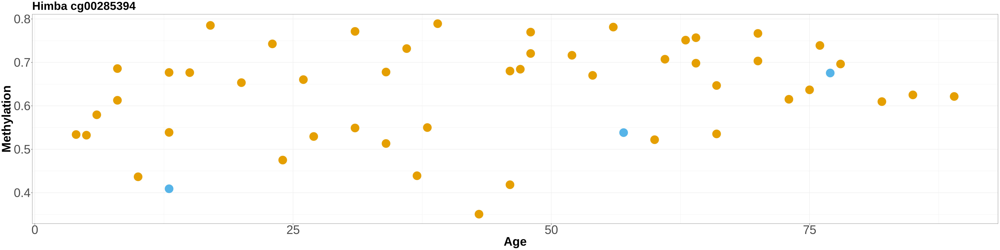

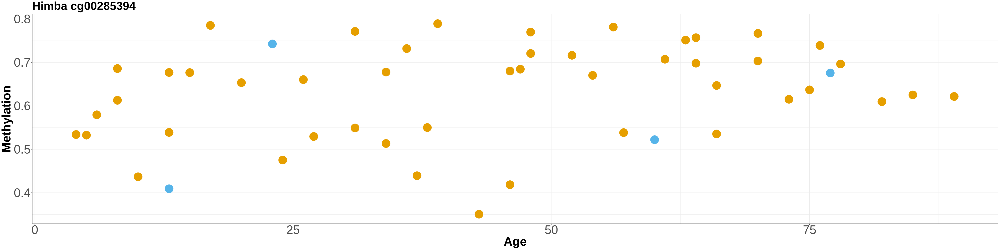

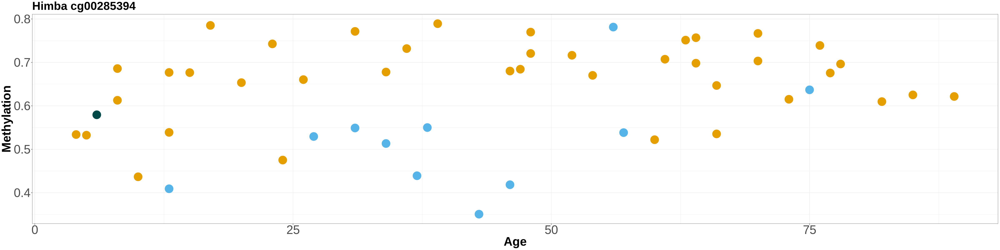

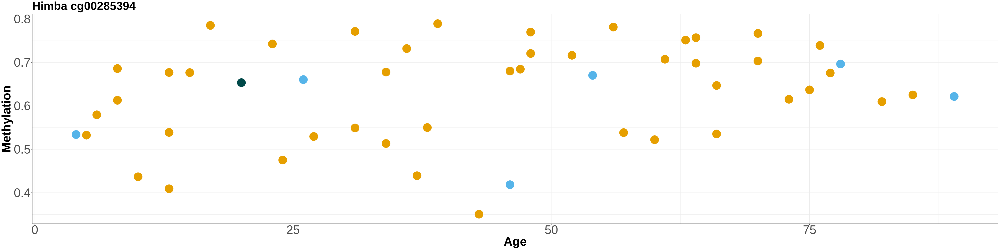

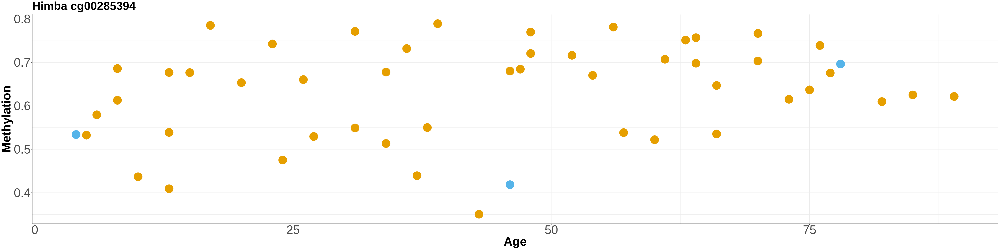

...

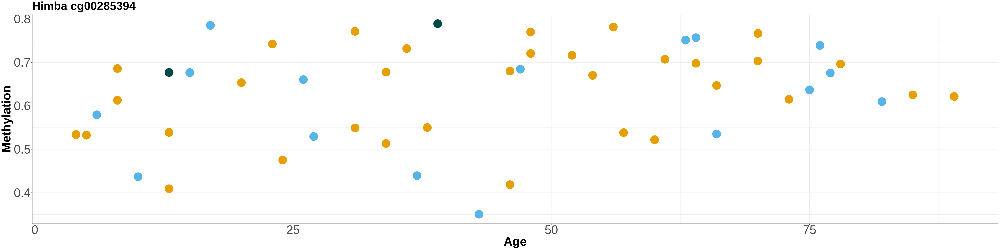

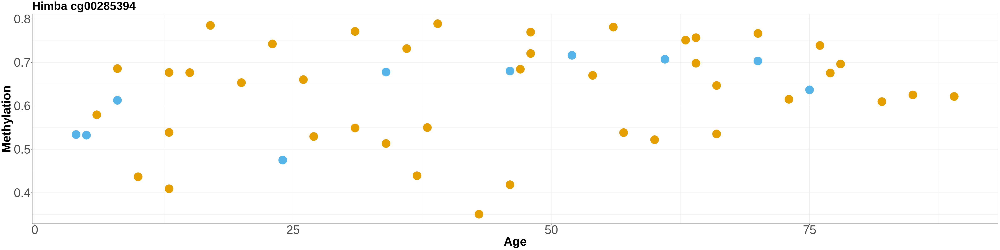

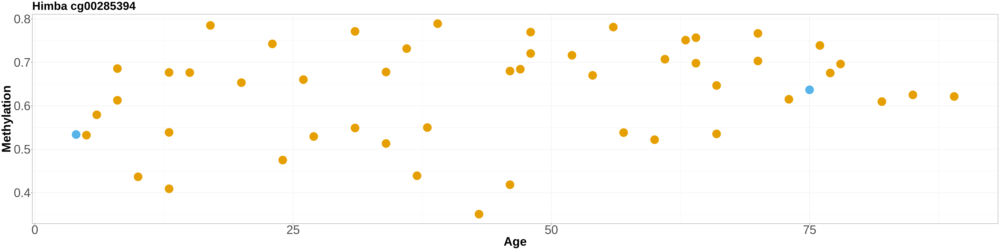

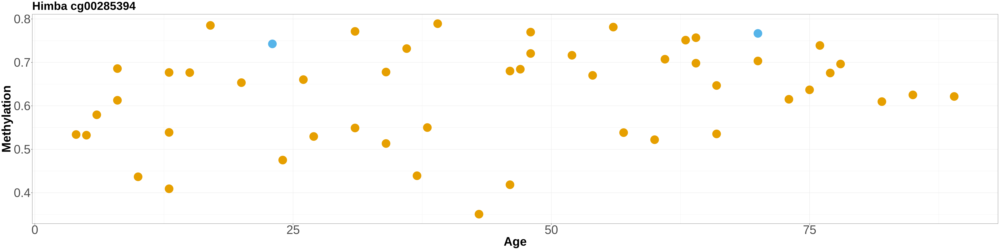

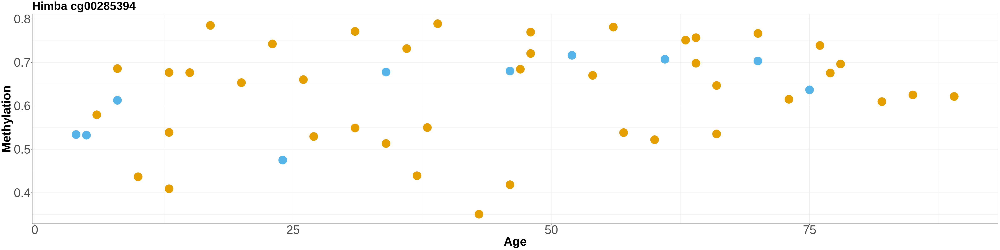

In [7]:
###test fusion ones that lose power
#######################
library("patchwork")
library("ggplot2")
library("dplyr")
cbPalette <- c("#E69F00", "#56B4E9", "#009E73", "#F0E442", "#0072B2", "#D55E00", "#CC79A7")

# Initialize a list to store plots for each population


for (pop_ in c("Himba")) {

  pop <- pop_
  # meta_ewas_regress <- FALSE
  # if (meta_ewas_regress) {
  #   sig <- meta_sig_regress
  # } else {
  #   sig <- meta_sig_no_regress
  # }

  # Load phenotype data based on the population
  if (pop == "KHS") {
    pheno <- KHS_pheno_merged
    rownames(pheno) <- pheno$IID
    tfam <- read.delim("/share/hennlab/users/glmeeks/age_methylation/EMMAX_meqtl/beta_meqtl_regress_KHS.tfam", sep = '', header = FALSE)
    n <- 52
  } else if (pop == "Baka") {
    pheno <- Baka_pheno
    rownames(pheno) <- pheno$IID
    tfam <- read.delim("/share/hennlab/users/glmeeks/age_methylation/EMMAX_meqtl/beta_meqtl_regress_Baka.tfam", sep = '', header = FALSE)
    n <- 35
  } else if (pop == "Himba") {
    pheno <- Himba_pheno_merged
    rownames(pheno) <- pheno$ID
    pheno$IID <- pheno$ID
    pheno <- pheno[!pheno$ID == "HMB181_2", ]
    n <- 51
    tfam <- read.delim("/share/hennlab/users/glmeeks/age_methylation/EMMAX_meqtl/beta_meqtl_regress_Himba.tfam", sep = '', header = FALSE)
  } else if (pop == "all") {
    load("/share/hennlab/users/glmeeks/age_methylation/age_prediction/merged_data_all_phenos.RData")
    pheno <- pheno_merged
    rownames(pheno) <- pheno$ID
    pheno$IID <- pheno$ID
    n <- 138
    tfam <- read.delim("/share/hennlab/users/glmeeks/age_methylation/EMMAX_meqtl/beta_all_no_regress.tfam", sep = '', header = FALSE)
  }

  meth_data <- get(paste0(pop, "_meth_data"))
  row_index <- which(colnames(meth_data) == "HMB494.2")
  names(meth_data)[row_index] <- "HMB494-2"
  pheno <- pheno[c(colnames(meth_data[, 5:ncol(meth_data)])), ]
  meth_ <- t(meth_data[, 5:ncol(meth_data)])
  colnames(meth_) <- meth_data$cpg
  meqtls_df <- read.delim(paste0("/share/hennlab/users/glmeeks/age_methylation/FUSION/", pop, "_fusion_summary_full_no_blup_FINAL.txt"), sep = "\t")


    #biggest p-val losses 
if(pop == "KHS"){biggest <- KHS_invariant}
if(pop == "Baka"){biggest <- Baka_invariant}
if(pop == "Himba"){biggest <- Himba_invariant[1]}

                   
  # Generate plots and store them in a list
  for (cpg_ in biggest) {
      cpg_plot_list <- list()
    meth <- as.data.frame(meth_[, colnames(meth_) == cpg_])
    meth$ID <- rownames(meth)
      
     snp_names <- as.list(strsplit(meqtls_df[meqtls_df$Site == cpg_, "To_regress_snps"], split=";")[[1]])
  
      for(snp_name in snp_names){
    
    file_path <- paste0(pop, "_meqtl_genos/", snp_name, "_meqtl.txt")
    snp_data <- read.delim(file_path, header = FALSE, sep = "|")
    snp_data$sum_alleles <- sapply(snp_data$V7, function(x) {
      if (x == "0/0") {
        return(0)
      } else if (x == "0/1") {
        return(1)
      } else if (x == "1/1") {
        return(2)
      } else {
        return(NA)
      }
    })
    snp_data$V6 <- gsub(".*_", "", snp_data$V6)
    rownames(snp_data) <- snp_data$V6
    snp_data <- snp_data[rownames(meth), ]
    pheno <- pheno[rownames(meth), ]
    snp_data$ID <- rownames(snp_data)
    snp_data$meth_value <- meth[match(snp_data$ID, meth$ID), 1]
    snp_data$age <- pheno[match(snp_data$ID, pheno$IID), "age"]
     gg <- ggplot(snp_data, aes(x = age, y = meth_value, color = factor(sum_alleles))) +
      geom_point(size = 11) +  # Increase point size here
      labs(x = "Age", y = "Methylation", title = paste0(pop, " ", cpg_), color = "Genotype") +
      theme_minimal() +
      scale_color_manual(values = c("#E69F00", "#56B4E9", "#004949")) +  # Adjust colors as needed
      theme_bw() + 
      theme(
        axis.text = element_text(size = 35),
        axis.title = element_text(size = 35, face = "bold",  margin = margin(r = 10)),
        plot.title = element_text(size = 33, face = "bold"),
        legend.text = element_text(size = 30),  # Increase legend text size
        legend.title = element_text(size = 30)  # Increase legend title size
      ) + theme(legend.position = "none") 

    cpg_plot_list[[snp_name]] <- gg

} }}
      
      
for(snp in snp_names){
    print(cpg_plot_list[[snp]])}

 

In [24]:
length(unique(Himba_invariant))
length(unique(Baka_invariant))
length(unique(KHS_invariant))

[1] 19

[1] 27

[1] 20